In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [9]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input,Conv2D
from tensorflow.keras import layers
from tensorflow.keras import activations
#Data preprocessing:
root='../input/kvasircvcpolyp/Kvasir-SEG'


In [10]:
import os
import random
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2
from glob import glob
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import Input
from tensorflow.keras.models import Model, load_model, save_model ,Sequential
from tensorflow.keras.layers import Input, Activation, BatchNormalization, Dropout, Lambda, Conv2D,MaxPooling2D, concatenate, Dense, Flatten, UpSampling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import backend as K

In [11]:
#loading masks and images into a list
image_files=os.listdir(os.path.join(root,'images'))
for item in range(len(image_files)):
    image_files[item]=root+'/images/'+image_files[item]
mask_files=os.listdir(os.path.join(root,'images'))
for item in range(len(mask_files)):
    mask_files[item]=root+'/masks/'+mask_files[item]
print(len(image_files))
print(len(mask_files))

1612
1612


In [12]:
#Assembling into dataframe
Polyp_Data=pd.DataFrame(
    {
        "images":image_files,
        "masks": mask_files,
    }
)
Polyp_Data.head()

,images,masks
0,../input/kvasircvcpolyp/Kvasir-SEG/images/cju7...,../input/kvasircvcpolyp/Kvasir-SEG/masks/cju7d...
1,../input/kvasircvcpolyp/Kvasir-SEG/images/cju3...,../input/kvasircvcpolyp/Kvasir-SEG/masks/cju30...
2,../input/kvasircvcpolyp/Kvasir-SEG/images/cju5...,../input/kvasircvcpolyp/Kvasir-SEG/masks/cju5x...
3,../input/kvasircvcpolyp/Kvasir-SEG/images/cju7...,../input/kvasircvcpolyp/Kvasir-SEG/masks/cju7d...
4,../input/kvasircvcpolyp/Kvasir-SEG/images/cju2...,../input/kvasircvcpolyp/Kvasir-SEG/masks/cju2r...


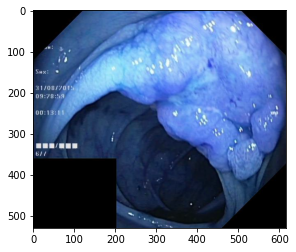

In [13]:
import matplotlib.pyplot as plt
plt.imshow((cv2.imread(Polyp_Data['images'].iloc[10],1)))
plt.show()

In [14]:

(Polyp_Data['images'].iloc[0])


'../input/kvasircvcpolyp/Kvasir-SEG/images/cju7d1tvt25bu08019dvw3uff.jpg'

In [52]:

(Polyp_Data['masks'].iloc[0])


'../input/polypkvasirclinicdb/Kvasir-SEG/masks/274.tif'

In [33]:
img=np.array(img,dtype=np.float32)
img=img/255


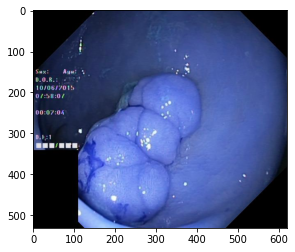

In [34]:
plt.imshow(img)
plt.show()

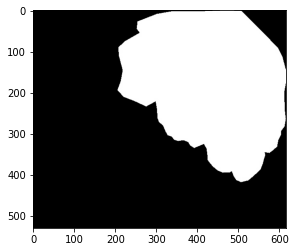

In [15]:
plt.imshow(np.array(cv2.imread(Polyp_Data['masks'].iloc[10])))
plt.show()


In [17]:
from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Input
from tensorflow.keras.models import Model
from tensorflow.keras.applications import ResNet50

def conv_block(input, num_filters):
    x = Conv2D(num_filters, 3, padding="same")(input)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(num_filters, 3, padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    return x

def decoder_block(input, skip_features, num_filters):
    x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(input)
    x = Concatenate()([x, skip_features])
    x = conv_block(x, num_filters)
    return x

def build_resnet50_unet(input_shape):
    """ Input """
    inputs = Input(input_shape)

    """ Pre-trained ResNet50 Model """
    resnet50 = ResNet50(include_top=False, weights="imagenet", input_tensor=inputs)

    """ Encoder """
    s1 = resnet50.get_layer("input_2").output           ## (512 x 512)
    s2 = resnet50.get_layer("conv1_relu").output        ## (256 x 256)
    s3 = resnet50.get_layer("conv2_block3_out").output  ## (128 x 128)
    s4 = resnet50.get_layer("conv3_block4_out").output  ## (64 x 64)

    """ Bridge """
    b1 = resnet50.get_layer("conv4_block6_out").output  ## (32 x 32)

    """ Decoder """
    d1 = decoder_block(b1, s4, 512)                     ## (64 x 64)
    d2 = decoder_block(d1, s3, 256)                     ## (128 x 128)
    d3 = decoder_block(d2, s2, 128)                     ## (256 x 256)
    d4 = decoder_block(d3, s1, 64)                      ## (512 x 512)

    """ Output """
    outputs = Conv2D(1, 1, padding="same", activation="sigmoid")(d4)

    model = Model(inputs, outputs, name="ResNet50_U-Net")
    return model


input_shape = (256,256,3)
model = build_resnet50_unet(input_shape)
model.summary()

Model: "ResNet50_U-Net"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 262, 262, 3)  0           input_2[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 128, 128, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 128, 128, 64) 256         conv1_conv[0][0]                 
_____________________________________________________________________________________

In [18]:
'''Function for preprocessing images'''
#---------------------------------------------------------------------------------------------------------------------------------------------------------#
def preprocess_data(img,mask):
    img = img / 255.
    mask = mask / 255.
    #Converting Masks into black and white images
    mask[mask>0.5]=1
    mask[mask<=0.5]=0
    return (img, mask)
#---------------------------------------------------------------------------------------------------------------------------------------------------------#
'''Function for data augmentation'''
def image_augmentor(
       data_frame, batch_size,
        aug_dict,
        image_color_mode="rgb",
        mask_color_mode="grayscale",
        image_save_prefix="image",
        mask_save_prefix="mask",
        save_to_dir=None,
        target_size=(512,512),
        seed=1):

    image_datagen = ImageDataGenerator(**aug_dict)#Data Generator for Images
    mask_datagen = ImageDataGenerator(**aug_dict) #Data Generator for Masks
    
   #----------------------------------------image augmentation for MRI scans-------------------------------------------------------------------------------
    image_generator = image_datagen.flow_from_dataframe(
        data_frame,
        x_col = "images",
        class_mode = None,
        color_mode = image_color_mode,
        target_size = target_size,
        batch_size = batch_size,
        save_to_dir = save_to_dir,
        save_prefix  = image_save_prefix,
        seed = seed)
   #-----------------------------------------------------image augmentation for masks-----------------------------------------------------------------------

    mask_generator = mask_datagen.flow_from_dataframe(
        data_frame,
        x_col = "masks",
        class_mode = None,
        color_mode = mask_color_mode,
        target_size = target_size,
        batch_size = batch_size,
        save_to_dir = save_to_dir,
        save_prefix  = mask_save_prefix,
        seed = seed)
  #--------------------------------------------------------------------------------------------------------------------------------------------------------
    train_augmentor = zip(image_generator, mask_generator)
    
    for (image, mask) in train_augmentor:
        image, mask = preprocess_data(image, mask)
        yield (image,mask)

In [19]:
smooth=1.
#-----------------------------------------------------------------------------------------------------------------------------------------------------------#
'''Function for returning dice coefficient'''
def DICE_COEFF(y_true, y_pred):
    y_true = K.flatten(y_true)
    y_pred = K.flatten(y_pred)
    intersection = K.sum(y_true * y_pred)
    union = K.sum(y_true) + K.sum(y_pred)
    return (2.0 * intersection + smooth) / (union + smooth)
#-----------------------------------------------------------------------------------------------------------------------------------------------------------#

'''Dice Coefficient Loss'''
def dice_coef_loss(y_true, y_pred):
    return 1 - DICE_COEFF(y_true, y_pred)

#----------------------------------------------------------------------------------------------------------------------------------------------------------#
'''Function for combining binary cross entropy with dice coeffcients for loss function'''
def bce_dice_loss(y_true, y_pred):
    bce = tf.keras.losses.BinaryCrossentropy()
    return dice_coef_loss(y_true, y_pred) + bce(y_true, y_pred)

#----------------------------------------------------------------------------------------------------------------------------------------------------------#

'''Function for Jacards coefficient'''
def IOU_JACARD(y_true, y_pred):
    y_true=K.flatten(y_true)
    y_pred=K.flatten(y_pred)
    intersection = K.sum(y_true * y_pred)
    sum_jac = K.sum(y_true + y_pred)
    jac = (intersection + smooth) / (sum_jac - intersection + smooth)
    return jac

In [20]:
EPOCHS = 100
BATCH_SIZE = 16
learning_rate = 1e-4

In [22]:
from sklearn.model_selection import train_test_split
Polyp_train,Polyp_test=train_test_split(Polyp_Data,test_size=0.18,random_state=0)
Polyp_test,Polyp_val=train_test_split(Polyp_test,test_size=0.6,random_state=0)
print('Shape of training data : {}\nShape of test data: {}\nShape of Validation data: {} '.format(len(Polyp_train),len(Polyp_test),len(Polyp_val)))

Shape of training data : 1321
Shape of test data: 116
Shape of Validation data: 175 


In [23]:
train_generator_args = dict(rotation_range=0.1,
                            width_shift_range=0.05,
                            height_shift_range=0.05,
                            shear_range=0.05,
                            zoom_range=0.05,
                            horizontal_flip=True,
                            vertical_flip=True,
                            fill_mode='nearest')

train_generator = image_augmentor(Polyp_train, BATCH_SIZE,
                                train_generator_args,
                                target_size=(256,256))
    
validation_generator = image_augmentor(Polyp_val, BATCH_SIZE,
                                dict(),
                                target_size=(256,256))

In [24]:
opt = Adam(learning_rate=learning_rate, beta_1=0.9, beta_2=0.999, epsilon=None, amsgrad=False)

callbacks = [ModelCheckpoint('Polyp_Segment.hdf5', verbose=0, save_best_only=True),
            ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, verbose=1, min_lr=1e-11),
            EarlyStopping(monitor='val_loss', restore_best_weights=True, patience=12)]

In [25]:
model.compile(optimizer=opt, loss=bce_dice_loss, metrics=[IOU_JACARD, DICE_COEFF])

In [26]:
history = model.fit(train_generator,
                    steps_per_epoch=len(Polyp_train) // 16, 
                    epochs=120, 
                    callbacks=callbacks,
                    validation_data = validation_generator,
                    validation_steps=len(Polyp_val) // 16)

Found 1321 validated image filenames.
Found 1321 validated image filenames.


2022-06-23 11:23:46.473619: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/120


2022-06-23 11:23:53.016227: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


82/82 [==============================] - ETA: 0s - loss: 0.8430 - IOU_JACARD: 0.3437 - DICE_COEFF: 0.4996Found 175 validated image filenames.
Found 175 validated image filenames.
82/82 [==============================] - 65s 617ms/step - loss: 0.8430 - IOU_JACARD: 0.3437 - DICE_COEFF: 0.4996 - val_loss: 1.3384 - val_IOU_JACARD: 0.1181 - val_DICE_COEFF: 0.2105
Epoch 2/120
82/82 [==============================] - 46s 549ms/step - loss: 0.4949 - IOU_JACARD: 0.5038 - DICE_COEFF: 0.6681 - val_loss: 1.2642 - val_IOU_JACARD: 0.0829 - val_DICE_COEFF: 0.1530
Epoch 3/120
82/82 [==============================] - 44s 542ms/step - loss: 0.4445 - IOU_JACARD: 0.5462 - DICE_COEFF: 0.7033 - val_loss: 1.3447 - val_IOU_JACARD: 0.0565 - val_DICE_COEFF: 0.1069
Epoch 4/120
82/82 [==============================] - 44s 541ms/step - loss: 0.3825 - IOU_JACARD: 0.5955 - DICE_COEFF: 0.7434 - val_loss: 1.4400 - val_IOU_JACARD: 0.0355 - val_DICE_COEFF: 0.0685
Epoch 5/120
82/82 [==============================] - 44s 

In [27]:
test_gen = image_augmentor(Polyp_test, BATCH_SIZE,
                                dict(),
                                target_size=(256,256))
results = model.evaluate(test_gen, steps=len(Polyp_test) / BATCH_SIZE)
print("Test IOU: ",results[1])
print("Test Dice Coefficent: ",results[2])

Found 116 validated image filenames.
Found 116 validated image filenames.
7/7 [==============================] - 2s 315ms/step - loss: 0.2676 - IOU_JACARD: 0.7132 - DICE_COEFF: 0.8298
Test IOU:  0.7132038474082947
Test Dice Coefficent:  0.8297881484031677


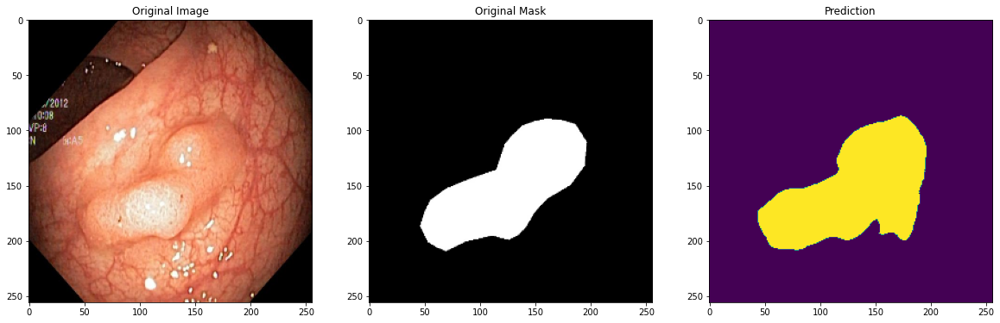

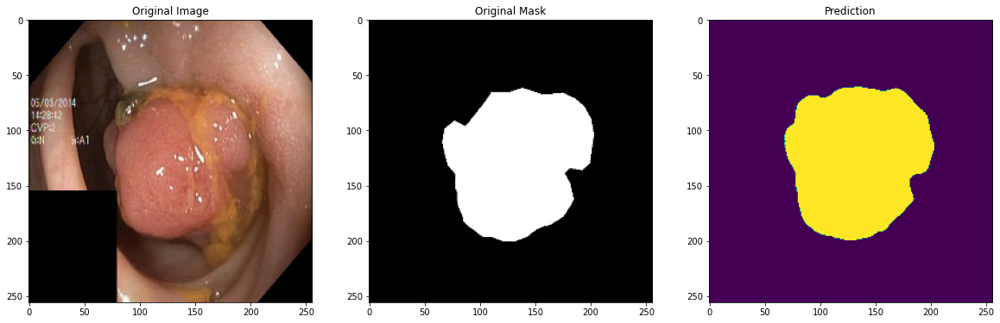

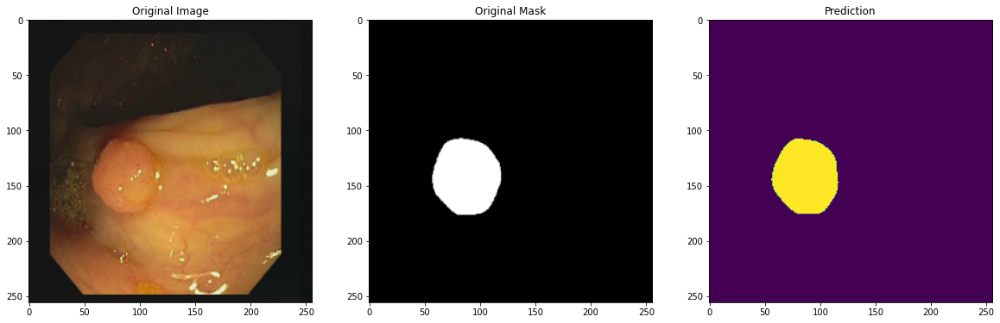

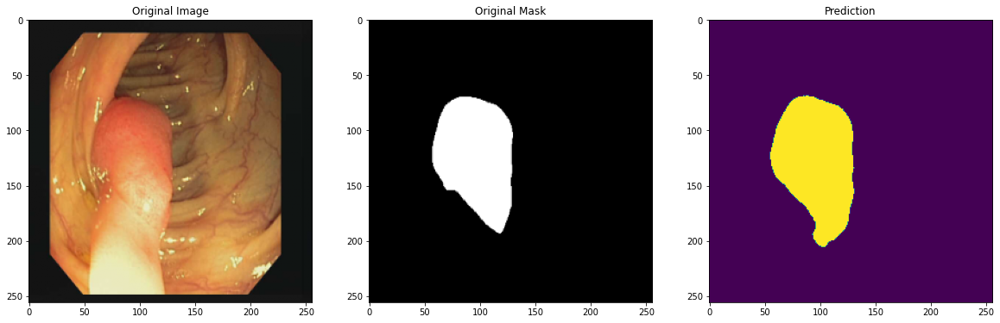

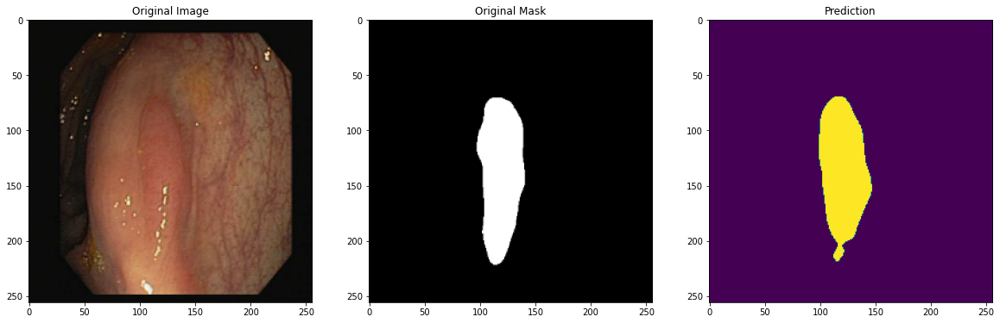

...

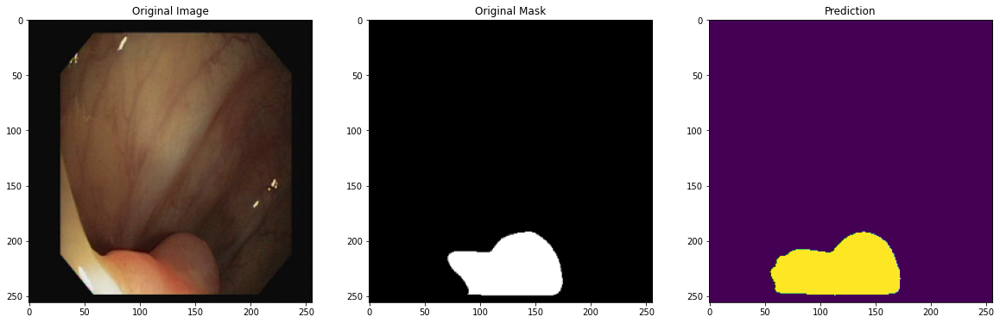

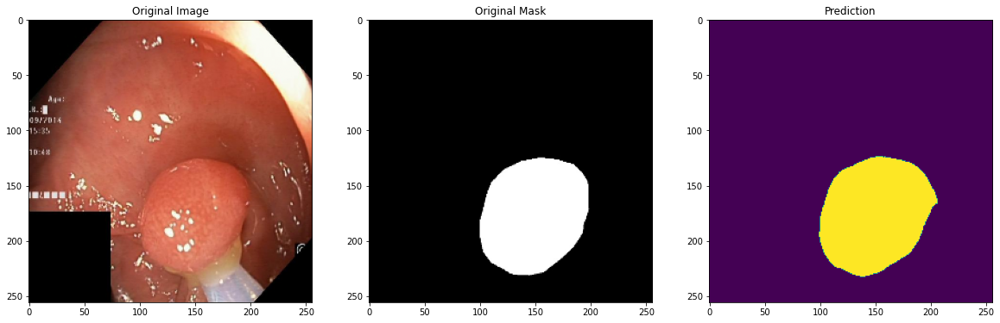

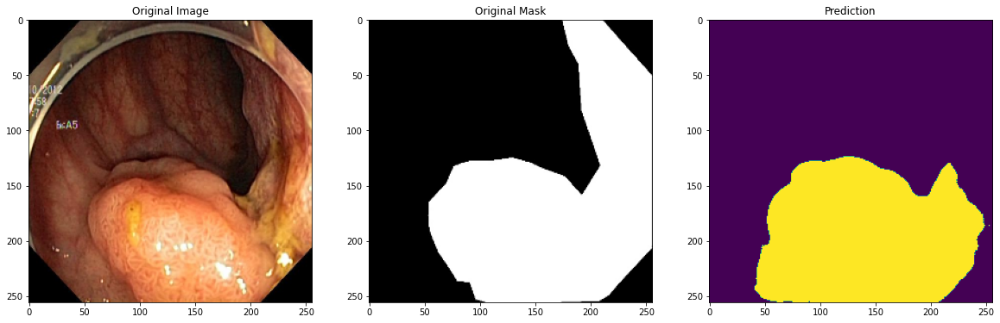

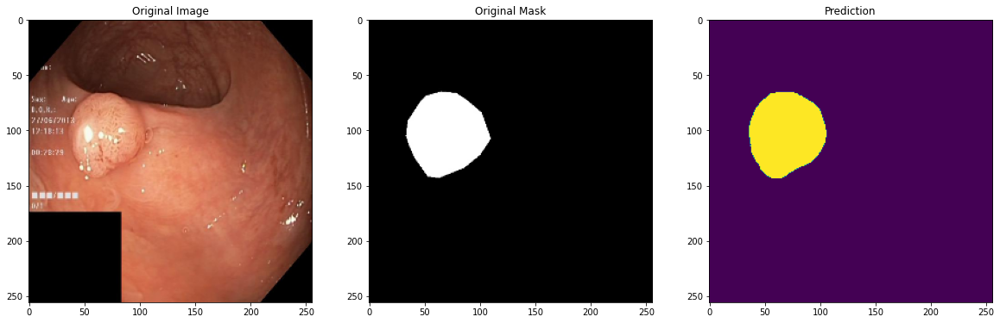

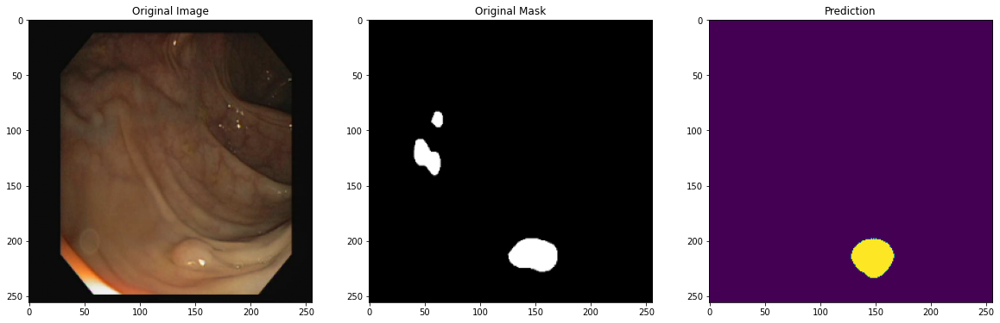

In [33]:
for i in range(100):
    index=np.random.randint(1,len(Polyp_test.index))
    img = cv2.imread(Polyp_test['images'].iloc[index])
    img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    img = cv2.resize(img ,(256,256))
    img = img / 255
    img = img[np.newaxis, :, :, :]
    pred=model.predict(img)

    plt.figure(figsize=(20,12))
    plt.subplot(1,3,1)
    plt.imshow(np.squeeze(img))
    plt.title('Original Image')
    plt.subplot(1,3,2)
    mask=np.squeeze(cv2.imread(Polyp_test['masks'].iloc[index]))
    mask=cv2.resize(mask,(256,256))
    plt.imshow(mask)
    plt.title('Original Mask')
    plt.subplot(1,3,3)
    plt.imshow(np.squeeze(pred) > .5)
    plt.title('Prediction')
    plt.show()